In [2]:
import fsspec
import geopandas as gpd
import h5netcdf
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import planetary_computer
import rasterio as rio
from contextily import add_basemap
from pystac_client import Client
from rasterio import transform, windows
from rasterio.enums import Resampling
from rasterio.features import rasterize
from rasterio.fill import fillnodata
from rasterio.warp import reproject
from scipy.ndimage import uniform_filter
from shapely import buffer, points
from shapely.geometry import box
from skimage.exposure import rescale_intensity

In [3]:
# Define the time window
temporal = "2021-06-01/2021-08-31"
sample_temporal = "2021-07-24"

In [4]:
# Load sample
sample = pd.read_csv("../data/Training_data_uhi_index_2025-02-18.csv")
sample

,Longitude,Latitude,datetime,UHI Index
0,-73.909167,40.813107,24-07-2021 15:53,1.030289
1,-73.909187,40.813045,24-07-2021 15:53,1.030289
2,-73.909215,40.812978,24-07-2021 15:53,1.023798
3,-73.909242,40.812908,24-07-2021 15:53,1.023798
4,-73.909257,40.812845,24-07-2021 15:53,1.021634
...,...,...,...,...
11224,-73.957050,40.790333,24-07-2021 15:57,0.972470
11225,-73.957063,40.790308,24-07-2021 15:57,0.972470
11226,-73.957093,40.790270,24-07-2021 15:57,0.981124
11227,-73.957112,40.790253,24-07-2021 15:59,0.981245


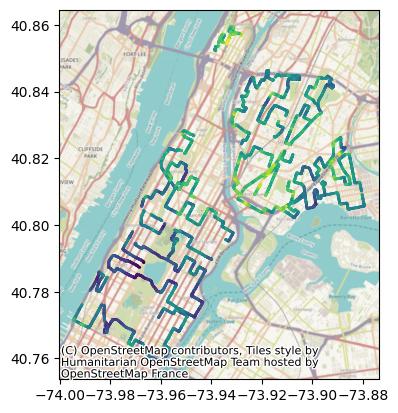

In [5]:
# Make sample into geospatial format
geometries = points(sample["Longitude"], sample["Latitude"])
sample = gpd.GeoDataFrame(sample, geometry=geometries, crs="EPSG:4326")

# Save it into a geojson
sample.to_file("sample.geojson")

# Plot it
ax = sample.plot(column="UHI Index", markersize=1)
add_basemap(ax, crs="EPSG:4326")

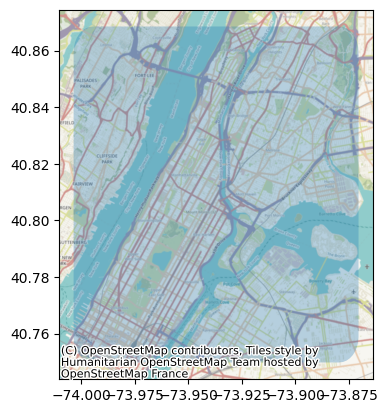

In [6]:
# Create bounds to filter data
polygon = buffer(box(*sample.total_bounds), 1000 / 111_000)
extent = gpd.GeoDataFrame(
    data=[dict(name="bounds")], geometry=[polygon], crs="EPSG:4326"
)
ax = extent.plot(alpha=0.3)
add_basemap(ax, crs="EPSG:4326")

extent.to_file("extent.geojson")

In [7]:
# Create optimal shapes of the data
# Defined images optimal shape in 30 meter
# 1 degree = 111.000 meter
bounds = tuple(extent.total_bounds)
width_10 = int(abs(bounds[0] - bounds[2]) * 111_000 / 10)
height_10 = int(abs(bounds[1] - bounds[3]) * 111_000 / 10)
shape_10 = (height_10, width_10)
print(f"Optimal Shapes 10 meter: {shape_10}")

width_30 = int(abs(bounds[0] - bounds[2]) * 111_000 / 30)
height_30 = int(abs(bounds[1] - bounds[3]) * 111_000 / 30)
shape_30 = (height_30, width_30)
print(f"Optimal Shapes 30 meter: {shape_30}")

Optimal Shapes 10 meter: (1317, 1476)
Optimal Shapes 30 meter: (439, 492)


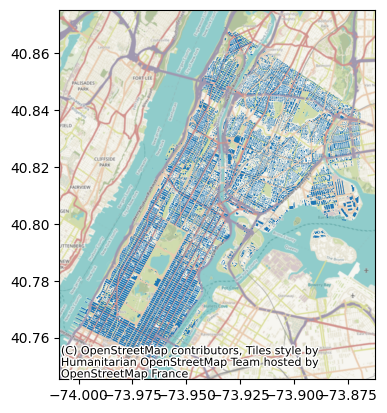

In [8]:
# Load building data
building = gpd.read_file("../data/Building_Footprint.kml").to_crs("EPSG:4326")
ax = building.plot()
add_basemap(ax, crs="EPSG:4326")

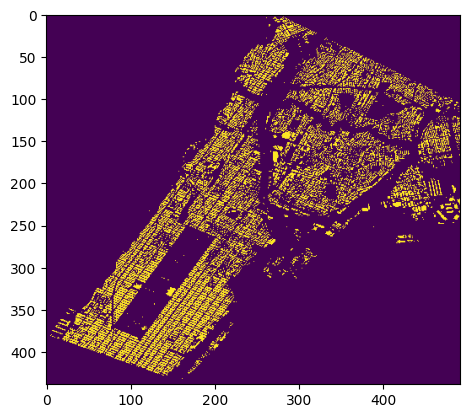

In [9]:
# Create a transform based on bounds
transform_extent_10 = transform.from_bounds(*bounds, height=height_10, width=width_10)
transform_extent_30 = transform.from_bounds(*bounds, height=height_30, width=width_30)

# Create raster of building
building_raster = rasterize(
    [(geom, 1) for geom in building.geometry],
    transform=transform_extent_30,
    fill=0,
    default_value=0,
    nodata=0,
    out_shape=shape_30,
)
plt.imshow(building_raster)

# Save the raster
with rio.open(
    "building.tif",
    "w",
    "COG",
    count=1,
    height=building_raster.shape[0],
    width=building_raster.shape[1],
    compress="zstd",
    resampling="nearest",
    dtype="uint8",
    nodata=0,
    crs="EPSG:4326",
    transform=transform_extent_30,
) as output:
    output.write(building_raster, 1)
    output.descriptions = tuple(["Building"])

In [10]:
# Client to search Sentinel-2 and Sentinel-1 data
client = Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1",
    modifier=planetary_computer.sign_inplace,
)

In [10]:
# Search for Landsat LST data
landsat_col = client.search(
    collections=["landsat-c2-l2"],
    bbox=bounds,
    datetime=temporal,
    filter={
        "op": "and",
        "args": [
            {
                "op": "or",
                "args": [
                    {"op": "=", "args": [{"property": "platform"}, "landsat-8"]},
                    {"op": "=", "args": [{"property": "platform"}, "landsat-9"]},
                ],
            },
            {"op": "=", "args": [{"property": "landsat:collection_category"}, "T1"]},
        ],
    },
).item_collection()
landsat_col

In [53]:
# Create a median composite
landsat_stacks = []

# Bands lst
landsat_bands = [
    "coastal",
    "blue",
    "green",
    "red",
    "nir08",
    "swir16",
    "swir22",
    "lwir11",
]

# Loop it
for x in range(len(landsat_col)):
    item = landsat_col[x]
    id = item.id
    print(f"Proceesing {id} ({x + 1} / {len(landsat_col)})")
    assets = item.assets

    # QA band for cloud masking
    with rio.open(assets["qa_pixel"].href) as source:
        bounds_crs = tuple(extent.to_crs(source.crs).total_bounds)
        window = windows.from_bounds(*bounds_crs, transform=source.transform)
        transform_window = windows.transform(window, source.transform)
        qa = source.read(1, boundless=True, window=window, fill_value=source.nodata)
        qa, new_transform = reproject(
            qa,
            np.empty(shape_30, dtype=qa.dtype),
            src_transform=transform_window,
            src_crs=source.crs,
            src_nodata=source.nodata,
            dst_transform=transform_extent_30,
            dst_crs="EPSG:4326",
            dst_nodata=source.nodata,
            resampling=Resampling.nearest,
        )
        cloud_mask = (
            ((qa & (1 << 1)) == 0)
            & ((qa & (1 << 2)) == 0)
            & ((qa & (1 << 3)) == 0)
            & ((qa & (1 << 4)) == 0)
        )

        del qa

    # Images per bands S2
    images = []
    for band in landsat_bands:
        print(f"Proceesing {band}")

        with rio.open(assets[band].href) as source:
            window = windows.from_bounds(*bounds_crs, transform=source.transform)
            transform_window = windows.transform(window, source.transform)
            image = source.read(
                1,
                boundless=True,
                window=window,
                fill_value=source.nodata,
            )

            image, new_transform = reproject(
                image,
                np.empty(shape_30, dtype=image.dtype),
                src_transform=transform_window,
                src_crs=source.crs,
                src_nodata=source.nodata,
                dst_transform=transform_extent_30,
                dst_crs="EPSG:4326",
                dst_nodata=source.nodata,
                resampling=Resampling.nearest,
            )

            mask = (image == source.nodata) | ~cloud_mask

            if band == "lwir11":
                image = (image * 0.00341802) + 149 - 273.15
            else:
                image = image * 0.0000275 - 0.2

            image = np.ma.array(
                image,
                mask=mask,
            )

            images.append(image)

            del image

    del cloud_mask

    # Make images into a stack
    images = np.ma.stack(images)

    # Put it into a whole stack
    landsat_stacks.append(images)

    del images

# Make s2 stacks into actual stacks
landsat_stacks = np.ma.stack(landsat_stacks)
landsat_stacks

Proceesing LC08_L2SP_014032_20210826_02_T1 (1 / 15)
Proceesing coastal
Proceesing blue
Proceesing green
Proceesing red
Proceesing nir08
Proceesing swir16
Proceesing swir22
Proceesing lwir11
Proceesing LC08_L2SP_014031_20210826_02_T1 (2 / 15)
Proceesing coastal
Proceesing blue
Proceesing green
Proceesing red
Proceesing nir08
Proceesing swir16
Proceesing swir22
Proceesing lwir11
Proceesing LC08_L2SP_013032_20210819_02_T1 (3 / 15)
Proceesing coastal
Proceesing blue
Proceesing green
Proceesing red
Proceesing nir08
Proceesing swir16
Proceesing swir22
Proceesing lwir11
Proceesing LC08_L2SP_014032_20210810_02_T1 (4 / 15)
Proceesing coastal
Proceesing blue
Proceesing green
Proceesing red
Proceesing nir08
Proceesing swir16
Proceesing swir22
Proceesing lwir11
Proceesing LC08_L2SP_014031_20210810_02_T1 (5 / 15)
Proceesing coastal
Proceesing blue
Proceesing green
Proceesing red
Proceesing nir08
Proceesing swir16
Proceesing swir22
Proceesing lwir11
Proceesing LC08_L2SP_014032_20210725_02_T1 (6 / 15

masked_array(
  data=[[[[0.0448325, 0.0448325, 0.042330000000000007, ...,
           0.026379999999999987, 0.027480000000000004,
           0.027480000000000004],
          [0.046564999999999995, 0.046564999999999995,
           0.03465750000000001, ..., 0.02687500000000001, 0.02814,
           0.02814],
          [0.04252249999999999, 0.04252249999999999,
           0.037077499999999985, ..., 0.02739749999999999,
           0.025664999999999993, 0.025664999999999993],
          ...,
          [0.09389249999999999, 0.08542250000000001,
           0.07505499999999998, ..., 0.138965, 0.1500475, --],
          [0.09185749999999998, 0.06339499999999998,
           0.07387250000000001, ..., 0.17776750000000002,
           0.17776750000000002, --],
          [--, --, 0.066695, ..., 0.1433375, 0.1433375, --]],

         [[0.053852500000000025, 0.053852500000000025,
           0.04895749999999999, ..., 0.02918499999999999,
           0.034052499999999986, 0.034052499999999986],
          [0.05

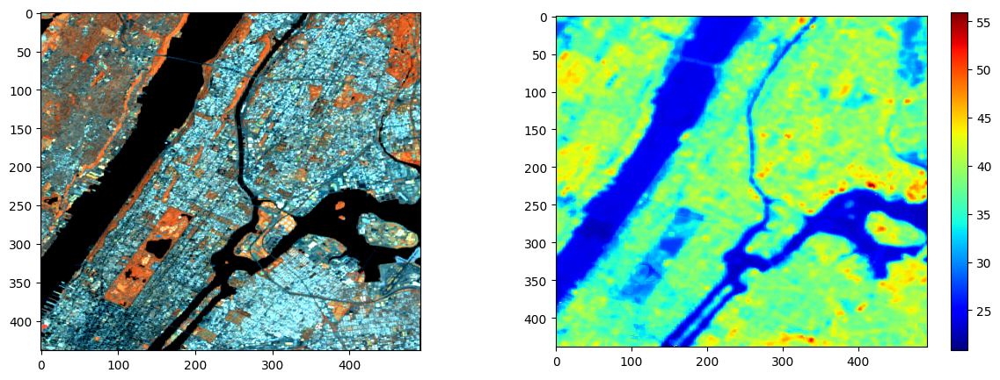

In [56]:
# Landsat combined
aggegate = np.ma.mean(landsat_stacks, 0)

plt.figure(figsize=(15, 5))

# Plot landsat median
landsat_composite = np.dstack(
    [
        rescale_intensity(aggegate[4], in_range=(0.1, 0.4)),
        rescale_intensity(aggegate[5], in_range=(0.05, 0.3)),
        rescale_intensity(aggegate[6], in_range=(0.025, 0.25)),
    ]
)
plt.subplot(1, 2, 1)
plt.imshow(landsat_composite)

lst_median = aggegate[-1]
plt.subplot(1, 2, 2)
plt.imshow(lst_median, cmap="jet")
plt.colorbar()

In [57]:
# Save landsat raster
# Save the image
landsat_output = np.nan_to_num(aggegate, nan=-9999)
with rio.open(
    "landsat.tif",
    "w",
    "COG",
    count=landsat_output.shape[0],
    height=landsat_output.shape[1],
    width=landsat_output.shape[2],
    compress="zstd",
    resampling="bilinear",
    dtype="float32",
    nodata=-9999,
    crs="EPSG:4326",
    transform=transform_extent_30,
) as output:
    output.write(landsat_output)
    output.descriptions = tuple(landsat_bands)

In [11]:
# Search for DEM data
dem_col = client.search(
    collections=["nasadem"],
    bbox=bounds,
).item_collection()
dem_col

In [12]:
# Combined the col in dem
dem_stacks = []

# Bands lst
dem_bands = ["elevation"]

# Loop it
for x in range(len(dem_col)):
    item = dem_col[x]
    id = item.id
    print(f"Proceesing {id} ({x + 1} / {len(dem_col)})")
    assets = item.assets

    # Images per bands S2
    images = []
    for band in dem_bands:
        print(f"Proceesing {band}")

        with rio.open(assets[band].href) as source:
            bounds_crs = tuple(extent.to_crs(source.crs).total_bounds)
            window = windows.from_bounds(*bounds_crs, transform=source.transform)
            transform_window = windows.transform(window, source.transform)
            image = source.read(
                1,
                boundless=True,
                window=window,
                fill_value=source.nodata,
            )
            image, new_transform = reproject(
                image,
                np.empty(shape_30, dtype=image.dtype),
                src_transform=transform_window,
                src_crs=source.crs,
                src_nodata=source.nodata,
                dst_transform=transform_extent_30,
                dst_crs="EPSG:4326",
                dst_nodata=source.nodata,
                resampling=Resampling.nearest,
            )
            image = np.ma.array(
                image,
                mask=(image == source.nodata),
            )
            images.append(image)

            del image

    # Make images into a stack
    images = np.ma.stack(images)

    # Put it into a whole stack
    dem_stacks.append(images)

    del images

dem_stacks = np.ma.stack(dem_stacks)
dem_stacks

Proceesing NASADEM_HGT_n40w075 (1 / 2)
Proceesing elevation
Proceesing NASADEM_HGT_n40w074 (2 / 2)
Proceesing elevation


masked_array(
  data=[[[[1, 1, 2, ..., --, --, --],
          [0, 1, 1, ..., --, --, --],
          [-1, 0, 1, ..., --, --, --],
          ...,
          [7, 5, 3, ..., --, --, --],
          [11, 9, 6, ..., --, --, --],
          [15, 12, 10, ..., --, --, --]]],


        [[[--, --, --, ..., 39, 42, 41],
          [--, --, --, ..., 39, 42, 43],
          [--, --, --, ..., 39, 41, 41],
          ...,
          [--, --, --, ..., 21, 21, 22],
          [--, --, --, ..., 22, 21, 21],
          [--, --, --, ..., 21, 20, 20]]]],
  mask=[[[[False, False, False, ...,  True,  True,  True],
          [False, False, False, ...,  True,  True,  True],
          [False, False, False, ...,  True,  True,  True],
          ...,
          [False, False, False, ...,  True,  True,  True],
          [False, False, False, ...,  True,  True,  True],
          [False, False, False, ...,  True,  True,  True]]],


        [[[ True,  True,  True, ..., False, False, False],
          [ True,  True,  True, ..., F

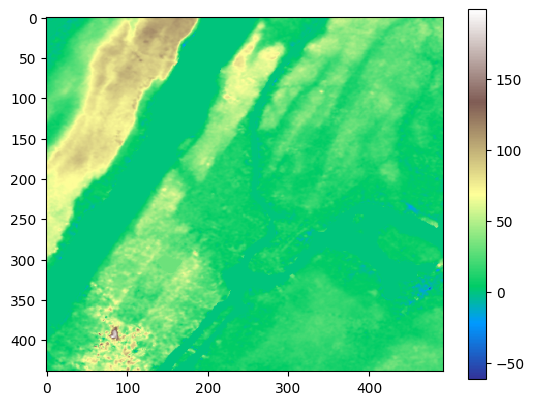

In [13]:
# Combined dem
dem = np.ma.max(dem_stacks, 0)[0]
plt.imshow(dem, cmap="terrain")
plt.colorbar()

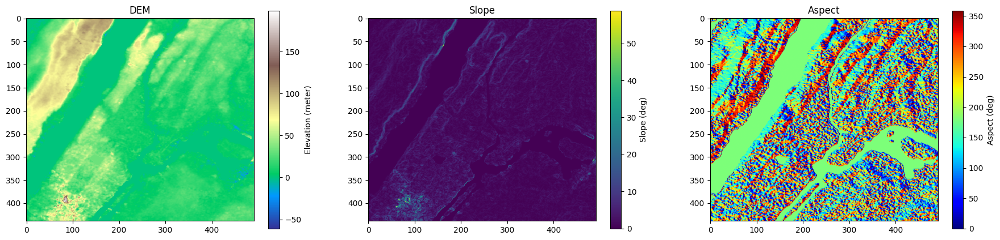

In [14]:
# Plot
plt.figure(figsize=(22, 5))

# Plot DEM
plt.subplot(1, 3, 1)
plt.title("DEM")
plt.imshow(dem, cmap="terrain")
plt.colorbar(label="Elevation (meter)")

# Pi
pi = 3.14159265359

# Make slope
py, px = np.gradient(dem, 100)
slope = np.sqrt((px**2) + (py**2))
slope_deg = slope / 1 * 90
slope_rad = slope_deg / 180 * pi
plt.subplot(1, 3, 2)
plt.title("Slope")
plt.imshow(slope_deg)
plt.colorbar(label="Slope (deg)")

# Make aspect
aspect = np.arctan2(py, -px)
aspect_normalized = np.degrees(aspect)
aspect_normalized = (aspect_normalized + 360) % 360
aspect_rad = aspect_normalized / 180 * pi

plt.subplot(1, 3, 3)
plt.title("Aspect")
plt.imshow(aspect_normalized, cmap="jet")
plt.colorbar(label="Aspect (deg)")

In [15]:
# Save DEM, slope, and aspect
topo = np.stack([dem, slope_rad, aspect_rad])

# Save dem raster
topo = np.nan_to_num(topo, nan=-9999)
with rio.open(
    "topography.tif",
    "w",
    "COG",
    count=topo.shape[0],
    height=topo.shape[1],
    width=topo.shape[2],
    compress="zstd",
    resampling="bilinear",
    dtype="float32",
    nodata=-9999,
    crs="EPSG:4326",
    transform=transform_extent_30,
) as output:
    output.write(topo)
    output.descriptions = tuple(["elevation", "slope", "aspect"])

In [10]:
# Search for sentinel-2 data
s2_col = client.search(
    collections=["sentinel-2-l2a"],
    bbox=bounds,
    datetime=temporal,
).item_collection()
s2_col

In [15]:
# Create a median composite
s2_stacks = []

# Bands s2
s2_bands = [
    "B01",
    "B02",
    "B03",
    "B04",
    "B05",
    "B06",
    "B07",
    "B08",
    "B8A",
    "B09",
    "B11",
    "B12",
]

# Loop it
for x in range(len(s2_col)):
    item = s2_col[x]
    id = item.id
    print(f"Proceesing {id} ({x + 1} / {len(s2_col)})")
    assets = item.assets

    # SCL band for cloud masking
    with rio.open(assets["SCL"].href) as source:
        bounds_crs = tuple(extent.to_crs(source.crs).total_bounds)
        window = windows.from_bounds(*bounds_crs, transform=source.transform)
        transform_window = windows.transform(window, source.transform)
        scl = source.read(1, boundless=True, window=window, fill_value=source.nodata)
        scl, new_transform = reproject(
            scl,
            np.empty(shape_10, dtype=scl.dtype),
            src_transform=transform_window,
            src_crs=source.crs,
            src_nodata=source.nodata,
            dst_transform=transform_extent_10,
            dst_crs="EPSG:4326",
            dst_nodata=source.nodata,
            resampling=Resampling.nearest,
        )
        cloud_mask = ((scl >= 1) & (scl <= 3)) | ((scl >= 7) & (scl <= 10))

        del scl

    # Images per bands S2
    images = []
    for band in s2_bands:
        print(f"Proceesing {band}")

        with rio.open(assets[band].href) as source:
            window = windows.from_bounds(*bounds_crs, transform=source.transform)
            transform_window = windows.transform(window, source.transform)
            image = source.read(
                1,
                boundless=True,
                window=window,
                fill_value=source.nodata,
            )
            image, new_transform = reproject(
                image,
                np.empty(shape_10, dtype=image.dtype),
                src_transform=transform_window,
                src_crs=source.crs,
                src_nodata=source.nodata,
                dst_transform=transform_extent_10,
                dst_crs="EPSG:4326",
                dst_nodata=source.nodata,
                resampling=Resampling.nearest,
            )
            image = np.ma.array(image / 1e4, mask=(image == source.nodata) | cloud_mask)
            images.append(image)

            del image

    del cloud_mask

    # Make images into a stack
    images = np.ma.stack(images)

    # Put it into a whole stack
    s2_stacks.append(images)

    del images

# Make s2 stacks into actual stacks
s2_stacks = np.ma.stack(s2_stacks)
s2_stacks

Proceesing S2A_MSIL2A_20210830T153911_R011_T18TWL_20210831T044104 (1 / 37)
Proceesing B01
Proceesing B02
Proceesing B03
Proceesing B04
Proceesing B05
Proceesing B06
Proceesing B07
Proceesing B08
Proceesing B8A
Proceesing B09
Proceesing B11
Proceesing B12
Proceesing S2B_MSIL2A_20210828T154809_R054_T18TWL_20210829T020751 (2 / 37)
Proceesing B01
Proceesing B02
Proceesing B03
Proceesing B04
Proceesing B05
Proceesing B06
Proceesing B07
Proceesing B08
Proceesing B8A
Proceesing B09
Proceesing B11
Proceesing B12
Proceesing S2B_MSIL2A_20210825T153809_R011_T18TWL_20210826T025515 (3 / 37)
Proceesing B01
Proceesing B02
Proceesing B03
Proceesing B04
Proceesing B05
Proceesing B06
Proceesing B07
Proceesing B08
Proceesing B8A
Proceesing B09
Proceesing B11
Proceesing B12
Proceesing S2A_MSIL2A_20210823T154911_R054_T18TWL_20210824T042422 (4 / 37)
Proceesing B01
Proceesing B02
Proceesing B03
Proceesing B04
Proceesing B05
Proceesing B06
Proceesing B07
Proceesing B08
Proceesing B8A
Proceesing B09
Proceesing

masked_array(
  data=[[[[--, --, --, ..., --, --, --],
          [--, --, --, ..., 0.142, 0.142, 0.142],
          [--, --, --, ..., 0.142, 0.142, 0.142],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [0.6487, 0.6487, 0.6487, ..., --, --, --]],

         [[--, --, --, ..., --, --, --],
          [--, --, --, ..., 0.077, 0.0882, 0.1168],
          [--, --, --, ..., 0.0834, 0.0934, 0.1108],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., 0.278, --, --]],

         [[--, --, --, ..., --, --, --],
          [--, --, --, ..., 0.0782, 0.0856, 0.1018],
          [--, --, --, ..., 0.0861, 0.0976, 0.1074],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., 0.3298, --, --]],

         ...,

         [[--, --, --, ..., --, --, --],
          [--, --, --, ..., 0.1785, 0.1785, 0.1785],
    

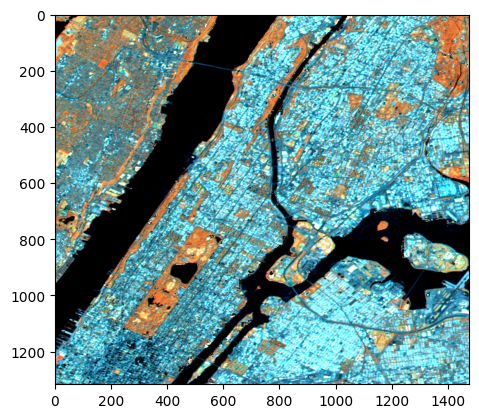

In [16]:
# Create a median composite
s2_median = np.ma.median(s2_stacks, 0)
s2_composite = np.dstack(
    [
        rescale_intensity(s2_median[7], in_range=(0.1, 0.4)),
        rescale_intensity(s2_median[10], in_range=(0.05, 0.3)),
        rescale_intensity(s2_median[11], in_range=(0.025, 0.25)),
    ]
)
plt.imshow(s2_composite)

In [17]:
# Save the image
s2_output = np.nan_to_num(s2_median, nan=-9999)
with rio.open(
    "s2_image.tif",
    "w",
    "COG",
    count=s2_output.shape[0],
    height=s2_output.shape[1],
    width=s2_output.shape[2],
    compress="zstd",
    resampling="bilinear",
    dtype="float32",
    nodata=-9999,
    crs="EPSG:4326",
    transform=transform_extent_10,
) as output:
    output.write(s2_output)
    output.descriptions = tuple(s2_bands)

In [18]:
# Search for sentinel-1 data
s1_col = client.search(
    collections=["sentinel-1-rtc"],
    bbox=bounds,
    datetime=temporal,
).item_collection()
s1_col

In [19]:
# Create a median composite
s1_stacks = []

# Bands s2
s1_bands = ["vv", "vh"]

# Loop it
for x in range(len(s1_col)):
    item = s1_col[x]
    id = item.id
    print(f"Proceesing {id} ({x + 1} / {len(s1_col)})")
    assets = item.assets

    # Images per bands S1
    images = []
    for band in s1_bands:
        print(f"Proceesing {band}")

        with rio.open(assets[band].href) as source:
            bounds_crs = tuple(extent.to_crs(source.crs).total_bounds)
            window = windows.from_bounds(*bounds_crs, transform=source.transform)
            transform_window = windows.transform(window, source.transform)
            image = source.read(
                1,
                boundless=True,
                window=window,
                fill_value=source.nodata,
            )
            image, new_transform = reproject(
                image,
                np.empty(shape_10, dtype=image.dtype),
                src_transform=transform_window,
                src_crs=source.crs,
                src_nodata=source.nodata,
                dst_transform=transform_extent_10,
                dst_crs="EPSG:4326",
                dst_nodata=source.nodata,
                resampling=Resampling.nearest,
            )
            image = np.ma.array(image, mask=image == source.nodata)
            images.append(image)

            del image

    # Make images into a stack
    images = np.ma.stack(images)

    # Put it into a whole stack
    s1_stacks.append(images)

    del images

# Make s2 stacks into actual stacks
s1_stacks = np.ma.stack(s1_stacks)
s1_stacks

Proceesing S1A_IW_GRDH_1SDV_20210819T225123_20210819T225148_039305_04A43C_rtc (1 / 7)
Proceesing vv
Proceesing vh
Proceesing S1A_IW_GRDH_1SDV_20210807T225122_20210807T225147_039130_049E33_rtc (2 / 7)
Proceesing vv
Proceesing vh
Proceesing S1A_IW_GRDH_1SDV_20210726T225121_20210726T225146_038955_0498AC_rtc (3 / 7)
Proceesing vv
Proceesing vh
Proceesing S1A_IW_GRDH_1SDV_20210714T225121_20210714T225146_038780_049371_rtc (4 / 7)
Proceesing vv
Proceesing vh
Proceesing S1A_IW_GRDH_1SDV_20210702T225120_20210702T225145_038605_048E26_rtc (5 / 7)
Proceesing vv
Proceesing vh
Proceesing S1A_IW_GRDH_1SDV_20210620T225119_20210620T225144_038430_0488EA_rtc (6 / 7)
Proceesing vv
Proceesing vh
Proceesing S1A_IW_GRDH_1SDV_20210608T225118_20210608T225143_038255_0483B4_rtc (7 / 7)
Proceesing vv
Proceesing vh


masked_array(
  data=[[[[--, 0.11246520280838013, 0.11246520280838013, ..., --, --,
           --],
          [--, 0.1441068798303604, 0.1441068798303604, ...,
           0.08932492882013321, 0.14435604214668274,
           0.14609546959400177],
          [--, 0.12543174624443054, 0.12543174624443054, ...,
           0.08861053735017776, 0.1787787824869156,
           0.20927153527736664],
          ...,
          [0.42963284254074097, 0.42963284254074097,
           0.4298689365386963, ..., 2.4330790042877197, --, --],
          [0.15150748193264008, 0.15150748193264008, 0.197068452835083,
           ..., 2.9493091106414795, --, --],
          [--, --, --, ..., 2.1881752014160156, --, --]],

         [[--, 0.01741306111216545, 0.01741306111216545, ..., --, --,
           --],
          [--, 0.022025203332304955, 0.022025203332304955, ...,
           0.04752668738365173, 0.06707039475440979,
           0.0726059153676033],
          [--, 0.02018003910779953, 0.02018003910779953, ...,
 

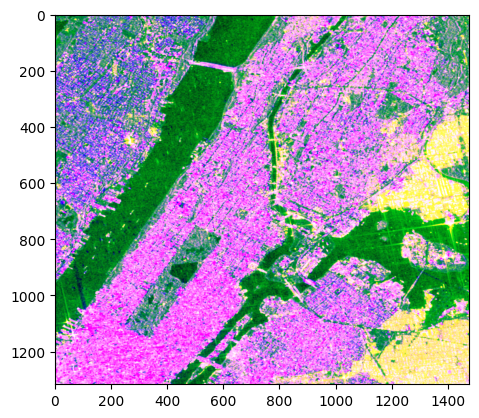

In [20]:
# Create a median composite
s1_median = np.ma.mean(s1_stacks, 0)
s1_median = uniform_filter(s1_median, 3, axes=(1, 2))
s1_composite = np.dstack(
    [
        rescale_intensity(s1_median[0], in_range=(0.1, 0.4)),
        rescale_intensity(
            (s1_median[0] - s1_median[1]) / (s1_median[0] + s1_median[1]),
            in_range=(0, 1),
        ),
        rescale_intensity(s1_median[1], in_range=(0, 0.1)),
    ]
)
plt.imshow(s1_composite)

In [21]:
# Save the image
s1_output = np.nan_to_num(s1_median, nan=-9999)
with rio.open(
    "s1_image.tif",
    "w",
    "COG",
    count=s1_output.shape[0],
    height=s1_output.shape[1],
    width=s1_output.shape[2],
    compress="zstd",
    resampling="bilinear",
    dtype="float32",
    nodata=-9999,
    crs="EPSG:4326",
    transform=transform_extent_10,
) as output:
    output.write(s1_output)
    output.description = tuple(s1_bands)

In [22]:
# Transformation for sentinel-3
bounds_buffer = tuple(extent.buffer(100_000 / 110_000).total_bounds)
polygon_buffer = box(*bounds_buffer)

width_100 = int(abs(bounds[0] - bounds[2]) * 111_000 / 100)
height_100 = int(abs(bounds[1] - bounds[3]) * 111_000 / 100)
shape_100 = (height_100, width_100)
transform_extent_100 = transform.from_bounds(
    *bounds_buffer, height=height_100, width=width_100
)
print(f"Optimal Shapes 100 meter: {shape_100}")

width_1000 = int(abs(bounds[0] - bounds[2]) * 111_000 / 1000)
height_1000 = int(abs(bounds[1] - bounds[3]) * 111_000 / 1000)
shape_1000 = (height_1000, width_1000)
transform_extent_1000 = transform.from_bounds(
    *bounds_buffer, height=height_1000, width=width_1000
)
print(f"Optimal Shapes 1000 meter: {shape_1000}")

Optimal Shapes 100 meter: (131, 147)
Optimal Shapes 1000 meter: (13, 14)


C:\Users\faisa\AppData\Local\Temp\ipykernel_27300\405470293.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  bounds_buffer = tuple(extent.buffer(100_000 / 110_000).total_bounds)


In [23]:
# Function to load netcdf data
def load_netcdf_to_numpy(source, variable):
    data = source.variables[variable]
    parameter = data.attrs
    data = data[:].astype("float32")
    if "_FillValue" in parameter:
        data[data == parameter["_FillValue"]] = np.nan
    if "scale_factor" in parameter:
        data = data * parameter["scale_factor"]
    if "add_offset" in parameter:
        data = data + parameter["add_offset"]
    return data

In [24]:
# Search for Sentinel-3 slstr
s3_lst_search = client.search(
    collections=["sentinel-3-slstr-lst-l2-netcdf"],
    bbox=bounds,
    datetime=sample_temporal,
).item_collection()
s3_lst_search

In [29]:
# All the LST and SST
s3_slstr_stack = []

In [30]:
# s3 lst
for x in range(len(s3_lst_search)):
    item = s3_lst_search[x]
    print(f"Processing {item.id} ({x + 1} / {len(s3_lst_search)})")
    assets = item.assets

    # Load geodata
    with fsspec.open(item.assets["slstr-geodetic-in"].href) as file:
        with h5netcdf.File(file, "r") as source:
            # Get longitude
            longitude = load_netcdf_to_numpy(source, "longitude_in")

            # Get latitude
            latitude = load_netcdf_to_numpy(source, "latitude_in")

    # Load lst data
    with fsspec.open(item.assets["lst-in"].href) as file:
        with h5netcdf.File(file, "r") as source:
            lst = load_netcdf_to_numpy(source, "LST") - 273.15

    # Dataframe
    geometries = points(longitude.flatten(), latitude.flatten())
    df = gpd.GeoDataFrame(dict(LST=lst.flatten()), geometry=geometries, crs="EPSG:4326")
    df = df.dropna()
    df = df.clip(polygon_buffer)

    # Rasterize
    rasterized_lst = rasterize(
        [feat for feat in zip(df.geometry, df["LST"])],
        out_shape=shape_100,
        transform=transform_extent_100,
        nodata=-9999,
        fill=-9999,
        default_value=-9999,
    )
    rasterized_lst = np.ma.array(rasterized_lst, mask=rasterized_lst == -9999)

    # Put it into a collection
    s3_slstr_stack.append(rasterized_lst)

Processing S3A_SL_2_LST_20210724T153453_20210724T153753_0179_074_225_2160 (1 / 3)
Processing S3B_SL_2_LST_20210724T145831_20210724T150131_0179_055_082_2340 (2 / 3)
Processing S3B_SL_2_LST_20210724T024137_20210724T024437_0179_055_075_0540 (3 / 3)


In [33]:
# sentinel-3 sst
s3_sst_search = client.search(
    collections=["sentinel-3-slstr-wst-l2-netcdf"],
    bbox=bounds,
    datetime=sample_temporal,
).item_collection()
s3_sst_search

In [34]:
# s3 sst
for x in range(len(s3_sst_search)):
    item = s3_sst_search[x]
    print(f"Processing {item.id} ({x + 1} / {len(s3_sst_search)})")
    assets = item.assets

    # Load geodata
    with fsspec.open(item.assets["l2p"].href) as file:
        with h5netcdf.File(file, "r") as source:
            # Get longitude
            longitude = load_netcdf_to_numpy(source, "lon")

            # Get latitude
            latitude = load_netcdf_to_numpy(source, "lat")

            # SST
            sst = load_netcdf_to_numpy(source, "sea_surface_temperature") - 273.15

    # Dataframe
    geometries = points(longitude.flatten(), latitude.flatten())
    df = gpd.GeoDataFrame(dict(SST=sst.flatten()), geometry=geometries, crs="EPSG:4326")
    df = df.dropna()
    df = df.clip(polygon_buffer)

    # Rasterize
    rasterized = rasterize(
        [feat for feat in zip(df.geometry, df["SST"])],
        out_shape=shape_100,
        transform=transform_extent_100,
        nodata=-9999,
        fill=-9999,
        default_value=-9999,
    )
    rasterized = np.ma.array(rasterized, mask=rasterized == -9999)

    # Put it into a collection
    s3_slstr_stack.append(rasterized)

Processing S3A_SL_2_WST_20210724T143336_20210724T161435_6059_074_224 (1 / 3)
Processing S3B_SL_2_WST_20210724T135414_20210724T153513_6059_055_081 (2 / 3)
Processing S3B_SL_2_WST_20210724T020720_20210724T034819_6059_055_074 (3 / 3)


In [35]:
# Stacked all data
s3_slstr_stack = np.ma.stack(s3_slstr_stack)
s3_slstr_stack

masked_array(
  data=[[[27.175994873046875, 26.964019775390625, 27.15802001953125,
          ..., 26.782012939453125, 25.287994384765625,
          28.722015380859375],
         [26.092010498046875, 25.813995361328125, 26.166015625, ...,
          28.1300048828125, 26.394012451171875, 25.43402099609375],
         [27.480010986328125, 26.522003173828125, 26.904022216796875,
          ..., 25.160003662109375, 25.365997314453125, 25.5],
         ...,
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --]],

        [[--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         ...,
         [35.77801513671875, 34.718017578125, 32.115997314453125, ...,
          --, --, --],
         [29.96600341796875, 31.02001953125, 30.141998291015625, ...,
          --, --, --],
         [28.816009521484375, --, 31.9739990234375, ..., --, --, --]],

        [[14.108001708984375, 14.

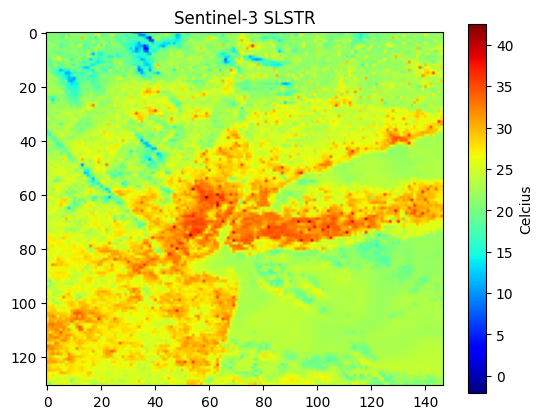

In [36]:
# Mean data s3 slstr
s3_slstr_mean = np.ma.mean(s3_slstr_stack, 0)
s3_slstr_mean = fillnodata(
    s3_slstr_mean,
    mask=~s3_slstr_mean.mask * 1,
    max_search_distance=3,
    smoothing_iterations=1,
)
plt.imshow(s3_slstr_mean, cmap="jet")
plt.colorbar(label="Celcius")
plt.title("Sentinel-3 SLSTR")
plt.show()

In [37]:
# Save with rasterio
# Save sentinel-3
s3_slstr_output = np.nan_to_num(s3_slstr_mean, nan=-9999)
with rio.open(
    "s3_slstr.tif",
    "w",
    "COG",
    width=s3_slstr_output.shape[1],
    height=s3_slstr_output.shape[0],
    count=1,
    transform=transform_extent_100,
    crs="EPSG:4326",
    dtype="float32",
    resample=Resampling.bilinear,
    nodata=-9999,
) as output:
    output.write(s3_slstr_output, 1)
    output.set_band_description(1, "SLSTR")

In [38]:
# Search for Sentinel-3 land
s3_land_search = client.search(
    collections=["sentinel-3-olci-lfr-l2-netcdf"],
    bbox=bounds,
    datetime=sample_temporal,
).item_collection()
s3_land_search

In [39]:
# s3 land
s3_land_stack = []
s3_land_dataset_name = ["IWV", "OGVI", "OTCI", "RC681", "RC865"]

for x in range(len(s3_land_search)):
    item = s3_land_search[x]
    print(f"Processing {item.id} ({x + 1} / {len(s3_land_search)})")
    assets = item.assets

    # Load geodata
    with fsspec.open(item.assets["geo-coordinates"].href) as file:
        with h5netcdf.File(file, "r") as source:
            longitude = load_netcdf_to_numpy(source, "longitude")
            latitude = load_netcdf_to_numpy(source, "latitude")

    # Dataset list
    with fsspec.open(item.assets["iwv"].href) as file:
        with h5netcdf.File(file, "r") as source:
            iwv = load_netcdf_to_numpy(source, "IWV")

    with fsspec.open(item.assets["ogvi"].href) as file:
        with h5netcdf.File(file, "r") as source:
            ogvi = load_netcdf_to_numpy(source, "OGVI")

    with fsspec.open(item.assets["otci"].href) as file:
        with h5netcdf.File(file, "r") as source:
            otci = load_netcdf_to_numpy(source, "OTCI")

    with fsspec.open(item.assets["rc-ogvi"].href) as file:
        with h5netcdf.File(file, "r") as source:
            rc681 = load_netcdf_to_numpy(source, "RC681")
            rc865 = load_netcdf_to_numpy(source, "RC865")

    dataset = np.stack(
        list(map(lambda y: y.flatten(), [iwv, ogvi, otci, rc681, rc865]))
    ).transpose(1, 0)

    # Dataframe
    geometries = points(longitude.flatten(), latitude.flatten())
    df = gpd.GeoDataFrame(
        dataset, columns=s3_land_dataset_name, geometry=geometries, crs="EPSG:4326"
    )
    df = df.dropna()
    df = df.clip(bounds_buffer)

    # Rasterized per bands
    rasterized_bands = []

    for y in s3_land_dataset_name:
        print(f"Rasterizing band {y}")

        # Rasterize
        rasterized_data = rasterize(
            [feat for feat in zip(df.geometry, df[y])],
            out_shape=shape_100,
            transform=transform_extent_100,
            nodata=-9999,
            fill=-9999,
            default_value=-9999,
        )
        rasterized_data = np.ma.array(rasterized_data, mask=rasterized_data == -9999)
        rasterized_bands.append(rasterized_data)

    # Make it into an np ma stack
    rasterized_bands = np.ma.stack(rasterized_bands)
    s3_land_stack.append(rasterized_bands)

# Rasterized S3 land stack
s3_land_stack = np.ma.stack(s3_land_stack)
s3_land_stack

Processing S3A_OL_2_LFR_20210724T153453_20210724T153753_0179_074_225_2160 (1 / 2)
Rasterizing band IWV
Rasterizing band OGVI
Rasterizing band OTCI
Rasterizing band RC681
Rasterizing band RC865
Processing S3B_OL_2_LFR_20210724T145831_20210724T150131_0179_055_082_2340 (2 / 2)
Rasterizing band IWV
Rasterizing band OGVI
Rasterizing band OTCI
Rasterizing band RC681
Rasterizing band RC865


masked_array(
  data=[[[[20.099998474121094, 19.499998092651367, 19.499998092651367,
           ..., 21.599998474121094, 20.399999618530273,
           21.599998474121094],
          [20.999998092651367, 20.999998092651367, 19.499998092651367,
           ..., 19.499998092651367, 20.999998092651367,
           22.19999885559082],
          [21.599998474121094, 19.799999237060547, 18.599998474121094,
           ..., 19.499998092651367, 20.099998474121094,
           22.19999885559082],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --]],

         [[0.8582677245140076, 0.7992125749588013, 0.7755905389785767,
           ..., 0.6968504190444946, 0.712598443031311,
           0.6614173054695129],
          [0.5905511975288391, 0.7086614370346069, 0.8149605989456177,
           ..., 0.7677165269851685, 0.6811023354530334,
           0.712598443031311],
          [0.5314960479736328, 0.8307086825370789, 0.59

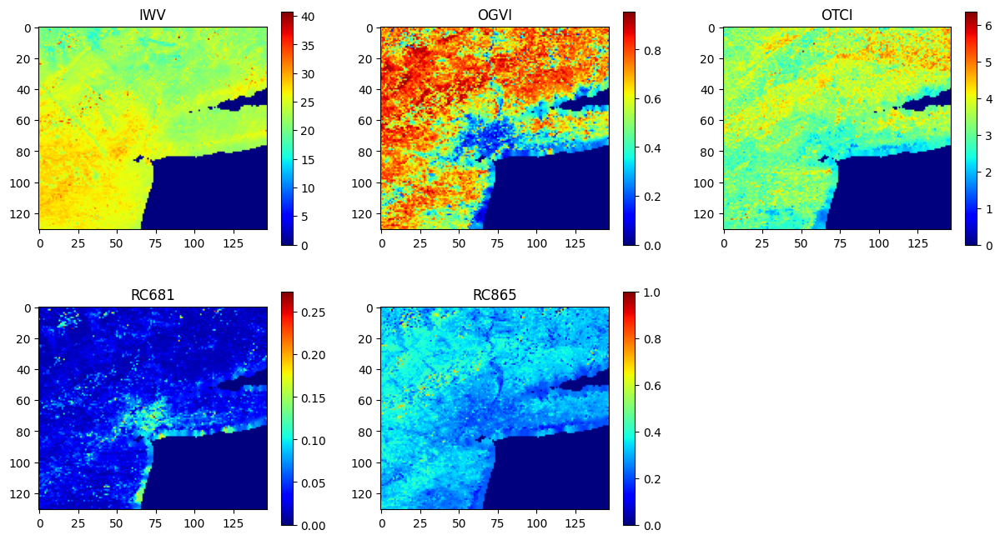

In [40]:
# Mean data s3 land
plt.figure(figsize=(15, 8))
s3_land_mean = np.ma.mean(s3_land_stack, 0)
for x in range(len(s3_land_dataset_name)):
    data = s3_land_mean[x]
    data = fillnodata(
        data,
        mask=~data.mask * 1,
        max_search_distance=3,
        smoothing_iterations=1,
    )
    s3_land_mean[x] = data
    plt.subplot(2, 3, x + 1)
    plt.imshow(data, cmap="jet")
    plt.colorbar()
    plt.title(f"{s3_land_dataset_name[x]}")
plt.show()

In [41]:
# Save with rasterio
# Save sentinel-3
s3_land_output = np.nan_to_num(s3_land_mean, nan=-9999)
with rio.open(
    "s3_land.tif",
    "w",
    "COG",
    width=s3_land_output.shape[2],
    height=s3_land_output.shape[1],
    count=s3_land_output.shape[0],
    transform=transform_extent_100,
    crs="EPSG:4326",
    dtype="float32",
    resample=Resampling.bilinear,
    nodata=-9999,
) as output:
    output.write(s3_land_output)
    output.descriptions = tuple(s3_land_dataset_name)

In [44]:
# sentinel-3 aerosol
s3_aerosol_search = client.search(
    collections=["sentinel-3-synergy-aod-l2-netcdf"],
    bbox=bounds,
    datetime=sample_temporal,
).item_collection()
s3_aerosol_search

In [45]:
# s3 aerosol
s3_aerosol_stack = []
s3_aerosol_dataset_name = [
    "AOD_440",
    "AOD_550",
    "AOD_670",
    "AOD_865",
    "AOD_1600",
    "AOD_2250",
]

for x in range(len(s3_aerosol_search)):
    item = s3_aerosol_search[x]
    print(f"Processing {item.id} ({x + 1} / {len(s3_aerosol_search)})")
    assets = item.assets

    # Load geodata
    with fsspec.open(item.assets["ntc-aod"].href) as file:
        with h5netcdf.File(file, "r") as source:
            longitude = load_netcdf_to_numpy(source, "longitude")
            latitude = load_netcdf_to_numpy(source, "latitude")
            aod440 = load_netcdf_to_numpy(source, "AOD_440")
            aod550 = load_netcdf_to_numpy(source, "AOD_550")
            aod670 = load_netcdf_to_numpy(source, "AOD_670")
            aod865 = load_netcdf_to_numpy(source, "AOD_865")
            aod1600 = load_netcdf_to_numpy(source, "AOD_1600")
            aod2250 = load_netcdf_to_numpy(source, "AOD_2250")

    dataset = np.stack(
        list(
            map(
                lambda y: y.flatten(),
                [aod440, aod550, aod670, aod865, aod1600, aod2250],
            )
        )
    ).transpose(1, 0)

    # Dataframe
    geometries = points(longitude.flatten(), latitude.flatten())
    df = gpd.GeoDataFrame(
        dataset, columns=s3_aerosol_dataset_name, geometry=geometries, crs="EPSG:4326"
    )
    df = df.dropna()
    df = df.clip(bounds_buffer)

    # Rasterized per bands
    rasterized_bands = []

    for y in s3_aerosol_dataset_name:
        print(f"Rasterizing band {y}")

        # Rasterize
        rasterized_data = rasterize(
            [feat for feat in zip(df.geometry, df[y])],
            out_shape=shape_100,
            transform=transform_extent_100,
            nodata=-9999,
            fill=-9999,
            default_value=-9999,
        )
        rasterized_data = np.ma.array(rasterized_data, mask=rasterized_data == -9999)
        rasterized_bands.append(rasterized_data)

    # Make it into an np ma stack
    rasterized_bands = np.ma.stack(rasterized_bands)
    s3_aerosol_stack.append(rasterized_bands)

# Rasterized S3 land stack
s3_aerosol_stack = np.ma.stack(s3_aerosol_stack)
s3_aerosol_stack


Processing S3A_SY_2_AOD_20210724T151936_20210724T160354_2658_074_225 (1 / 2)
Rasterizing band AOD_440
Rasterizing band AOD_550
Rasterizing band AOD_670
Rasterizing band AOD_865
Rasterizing band AOD_1600
Rasterizing band AOD_2250
Processing S3B_SY_2_AOD_20210724T144014_20210724T152432_2658_055_082 (2 / 2)
Rasterizing band AOD_440
Rasterizing band AOD_550
Rasterizing band AOD_670
Rasterizing band AOD_865
Rasterizing band AOD_1600
Rasterizing band AOD_2250


masked_array(
  data=[[[[--, --, --, ..., 0.22209998965263367, --, --],
          [--, --, 0.49879997968673706, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, 0.5270999670028687, ..., --, --, --],
          [--, --, --, ..., --, --, --]],

         [[--, --, --, ..., 0.15219999849796295, --, --],
          [--, --, 0.34199997782707214, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, 0.3791999816894531, ..., --, --, --],
          [--, --, --, ..., --, --, --]],

         [[--, --, --, ..., 0.10659999400377274, --, --],
          [--, --, 0.23959998786449432, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, 0.2831999957561493, ..., --, --, --],
          [--, --, --, ..., --, --, --]],

         [[--, --, --, ..., 0.05829999968409538

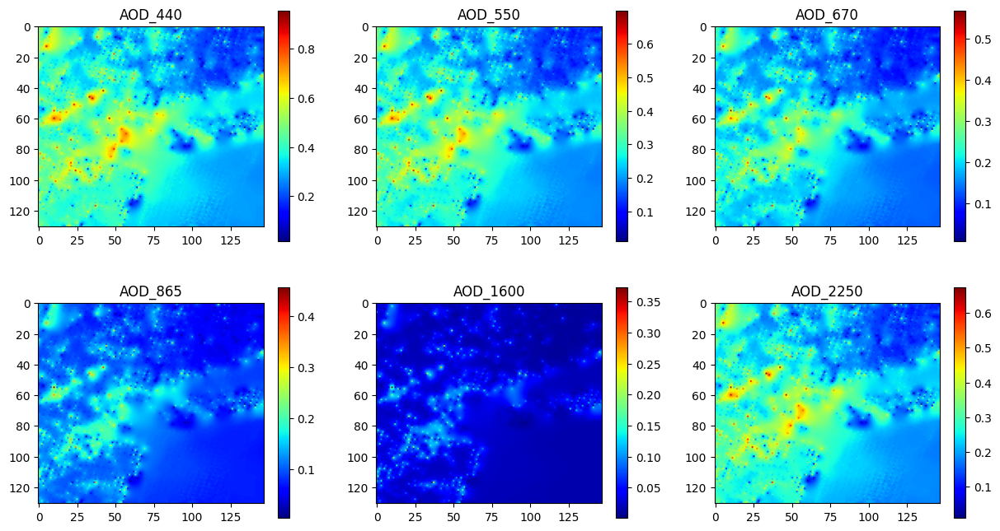

In [46]:
# Mean data s3 aerosol
plt.figure(figsize=(15, 8))
s3_aerosol_mean = np.ma.mean(s3_aerosol_stack, 0)
for x in range(len(s3_aerosol_dataset_name)):
    data = s3_aerosol_mean[x]
    data = fillnodata(
        data,
        mask=~data.mask * 1,
        max_search_distance=100,
        smoothing_iterations=10,
    )
    s3_aerosol_mean[x] = data
    plt.subplot(2, 3, x + 1)
    plt.imshow(data, cmap="jet")
    plt.colorbar()
    plt.title(f"{s3_aerosol_dataset_name[x]}")
plt.show()

In [47]:
# Save with rasterio
# Save sentinel-3
s3_aerosol_output = np.nan_to_num(s3_aerosol_mean, nan=-9999)
with rio.open(
    "s3_aerosol.tif",
    "w",
    "COG",
    width=s3_aerosol_output.shape[2],
    height=s3_aerosol_output.shape[1],
    count=s3_aerosol_output.shape[0],
    transform=transform_extent_100,
    crs="EPSG:4326",
    dtype="float32",
    resample=Resampling.bilinear,
    nodata=-9999,
) as output:
    output.write(s3_aerosol_output)
    output.descriptions = tuple(s3_aerosol_dataset_name)


In [48]:
# Search for Sentinel-3 water
s3_water_search = client.search(
    collections=["sentinel-3-olci-wfr-l2-netcdf"],
    bbox=bounds,
    datetime=sample_temporal,
).item_collection()
s3_water_search

In [49]:
# s3 water
s3_water_stack = []
s3_water_dataset_name = ["IWV_Water", "PAR", "KD490_M07", "A865", "T865", "CHL_NN"]

for x in range(len(s3_water_search)):
    item = s3_water_search[x]
    print(f"Processing {item.id} ({x + 1} / {len(s3_water_search)})")
    assets = item.assets

    # Load geodata
    with fsspec.open(item.assets["geo-coordinates"].href) as file:
        with h5netcdf.File(file, "r") as source:
            longitude = load_netcdf_to_numpy(source, "longitude")
            latitude = load_netcdf_to_numpy(source, "latitude")

    # Dataset list
    with fsspec.open(item.assets["iwv"].href) as file:
        with h5netcdf.File(file, "r") as source:
            iwv = load_netcdf_to_numpy(source, "IWV")

    with fsspec.open(item.assets["par"].href) as file:
        with h5netcdf.File(file, "r") as source:
            par = load_netcdf_to_numpy(source, "PAR")

    with fsspec.open(item.assets["trsp"].href) as file:
        with h5netcdf.File(file, "r") as source:
            trsp = load_netcdf_to_numpy(source, "KD490_M07")

    with fsspec.open(item.assets["w-aer"].href) as file:
        with h5netcdf.File(file, "r") as source:
            a865 = load_netcdf_to_numpy(source, "A865")
            t865 = load_netcdf_to_numpy(source, "T865")

    with fsspec.open(item.assets["chl-nn"].href) as file:
        with h5netcdf.File(file, "r") as source:
            chl_nn = load_netcdf_to_numpy(source, "CHL_NN")
    dataset = np.stack(
        list(map(lambda y: y.flatten(), [iwv, par, trsp, a865, t865, chl_nn]))
    ).transpose(1, 0)

    # Dataframe
    geometries = points(longitude.flatten(), latitude.flatten())
    df = gpd.GeoDataFrame(
        dataset, columns=s3_water_dataset_name, geometry=geometries, crs="EPSG:4326"
    )
    df = df.dropna()
    df = df.clip(bounds_buffer)

    # Rasterized per bands
    rasterized_bands = []

    for y in s3_water_dataset_name:
        print(f"Rasterizing band {y}")

        # Rasterize
        rasterized_data = rasterize(
            [feat for feat in zip(df.geometry, df[y])],
            out_shape=shape_100,
            transform=transform_extent_100,
            nodata=-9999,
            fill=-9999,
            default_value=-9999,
        )
        rasterized_data = np.ma.array(rasterized_data, mask=rasterized_data == -9999)
        rasterized_bands.append(rasterized_data)

    # Make it into an np ma stack
    rasterized_bands = np.ma.stack(rasterized_bands)
    s3_water_stack.append(rasterized_bands)

# Rasterized S3 land stack
s3_water_stack = np.ma.stack(s3_water_stack)
s3_water_stack

Processing S3A_OL_2_WFR_20210724T153453_20210724T153753_0179_074_225_2160 (1 / 2)
Rasterizing band IWV_Water
Rasterizing band PAR
Rasterizing band KD490_M07
Rasterizing band A865
Rasterizing band T865
Rasterizing band CHL_NN
Processing S3B_OL_2_WFR_20210724T145831_20210724T150131_0179_055_082_2340 (2 / 2)
Rasterizing band IWV_Water
Rasterizing band PAR
Rasterizing band KD490_M07
Rasterizing band A865
Rasterizing band T865
Rasterizing band CHL_NN


masked_array(
  data=[[[[--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --]],

         [[--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --]],

         [[--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --]],

         [[--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --,

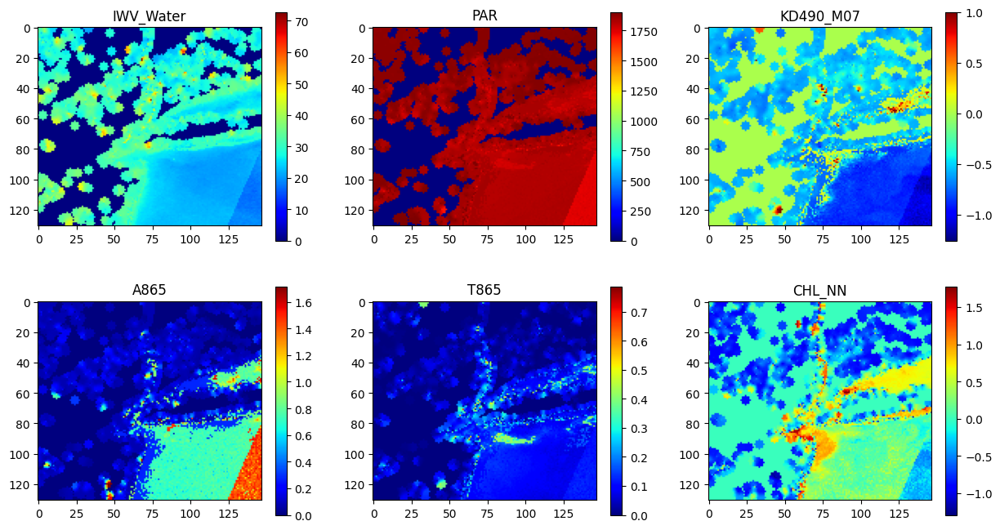

In [50]:
# Mean data s3 water
plt.figure(figsize=(15, 8))
s3_water_mean = np.ma.mean(s3_water_stack, 0)
for x in range(len(s3_water_dataset_name)):
    data = s3_water_mean[x]
    data = fillnodata(
        data,
        mask=~data.mask * 1,
        max_search_distance=3,
        smoothing_iterations=1,
    )
    s3_water_mean[x] = data
    plt.subplot(2, 3, x + 1)
    plt.imshow(data, cmap="jet")
    plt.colorbar()
    plt.title(f"{s3_water_dataset_name[x]}")
plt.show()

In [51]:
# Save with rasterio
# Save sentinel-3 water
s3_water_output = np.nan_to_num(s3_water_mean, nan=-9999)
with rio.open(
    "s3_water.tif",
    "w",
    "COG",
    width=s3_water_output.shape[2],
    height=s3_water_output.shape[1],
    count=s3_water_output.shape[0],
    transform=transform_extent_100,
    crs="EPSG:4326",
    dtype="float32",
    resample=Resampling.bilinear,
    nodata=-9999,
) as output:
    output.write(s3_water_output)
    output.descriptions = tuple(s3_water_dataset_name)


In [52]:
# Sentinel-3 SR
s3_sr_search = client.search(
    collections=["sentinel-3-synergy-syn-l2-netcdf"],
    bbox=bounds,
    datetime=sample_temporal,
).item_collection()
s3_sr_search

In [53]:
# s3 sr
s3_sr_stack = []
s3_sr_dataset_name = [
    dict(asset="syn-ato550", var="T550"),
    dict(asset="syn-s1n-reflectance", var="SDR_S1N"),
    dict(asset="syn-s1o-reflectance", var="SDR_S1O"),
    dict(asset="syn-s2n-reflectance", var="SDR_S2N"),
    dict(asset="syn-s2o-reflectance", var="SDR_S2O"),
    dict(asset="syn-s3n-reflectance", var="SDR_S3N"),
    dict(asset="syn-s3o-reflectance", var="SDR_S3O"),
    dict(asset="syn-s5n-reflectance", var="SDR_S5N"),
    dict(asset="syn-s5o-reflectance", var="SDR_S5O"),
    dict(asset="syn-s6n-reflectance", var="SDR_S6N"),
    dict(asset="syn-s6o-reflectance", var="SDR_S6O"),
    dict(asset="syn-oa01-reflectance", var="SDR_Oa01"),
    dict(asset="syn-oa02-reflectance", var="SDR_Oa02"),
    dict(asset="syn-oa03-reflectance", var="SDR_Oa03"),
    dict(asset="syn-oa04-reflectance", var="SDR_Oa04"),
    dict(asset="syn-oa05-reflectance", var="SDR_Oa05"),
    dict(asset="syn-oa06-reflectance", var="SDR_Oa06"),
    dict(asset="syn-oa07-reflectance", var="SDR_Oa07"),
    dict(asset="syn-oa08-reflectance", var="SDR_Oa08"),
    dict(asset="syn-oa09-reflectance", var="SDR_Oa09"),
    dict(asset="syn-oa10-reflectance", var="SDR_Oa10"),
    dict(asset="syn-oa11-reflectance", var="SDR_Oa11"),
    dict(asset="syn-oa12-reflectance", var="SDR_Oa12"),
    dict(asset="syn-oa16-reflectance", var="SDR_Oa16"),
    dict(asset="syn-oa17-reflectance", var="SDR_Oa17"),
    dict(asset="syn-oa18-reflectance", var="SDR_Oa18"),
    dict(asset="syn-oa21-reflectance", var="SDR_Oa21"),
]
s3_sr_band_names = list(map(lambda x: x["var"], s3_sr_dataset_name))

for x in range(len(s3_sr_search)):
    item = s3_sr_search[x]
    print(f"Processing {item.id} ({x + 1} / {len(s3_sr_search)})")
    assets = item.assets

    # Load geodata
    with fsspec.open(item.assets["geolocation"].href) as file:
        with h5netcdf.File(file, "r") as source:
            longitude = load_netcdf_to_numpy(source, "lon")
            latitude = load_netcdf_to_numpy(source, "lat")

    dataset_sr = []
    for y in range(len(s3_sr_dataset_name)):
        prop = s3_sr_dataset_name[y]
        with fsspec.open(item.assets[prop["asset"]].href) as file:
            with h5netcdf.File(file, "r") as source:
                print(f"Processing {prop['asset']}")
                data = load_netcdf_to_numpy(source, prop["var"])
                dataset_sr.append(data)

    dataset = np.stack(list(map(lambda y: y.flatten(), dataset_sr))).transpose(1, 0)

    # Dataframe
    geometries = points(longitude.flatten(), latitude.flatten())
    df = gpd.GeoDataFrame(
        dataset, columns=s3_sr_band_names, geometry=geometries, crs="EPSG:4326"
    )
    df = df.dropna()
    df = df.clip(bounds_buffer)

    # Rasterized per bands
    rasterized_bands = []

    for y in s3_sr_band_names:
        print(f"Rasterizing band {y}")

        # Rasterize
        rasterized_data = rasterize(
            [feat for feat in zip(df.geometry, df[y])],
            out_shape=shape_100,
            transform=transform_extent_100,
            nodata=-9999,
            fill=-9999,
            default_value=-9999,
        )
        rasterized_data = np.ma.array(rasterized_data, mask=rasterized_data == -9999)
        rasterized_bands.append(rasterized_data)

    # Make it into an np ma stack
    rasterized_bands = np.ma.stack(rasterized_bands)
    s3_sr_stack.append(rasterized_bands)

# Rasterized S3 land stack
s3_sr_stack = np.ma.stack(s3_sr_stack)
s3_sr_stack


Processing S3A_SY_2_SYN_20210724T153453_20210724T153753_0179_074_225_2160 (1 / 2)
Processing syn-ato550
Processing syn-s1n-reflectance
Processing syn-s1o-reflectance
Processing syn-s2n-reflectance
Processing syn-s2o-reflectance
Processing syn-s3n-reflectance
Processing syn-s3o-reflectance
Processing syn-s5n-reflectance
Processing syn-s5o-reflectance
Processing syn-s6n-reflectance
Processing syn-s6o-reflectance
Processing syn-oa01-reflectance
Processing syn-oa02-reflectance
Processing syn-oa03-reflectance
Processing syn-oa04-reflectance
Processing syn-oa05-reflectance
Processing syn-oa06-reflectance
Processing syn-oa07-reflectance
Processing syn-oa08-reflectance
Processing syn-oa09-reflectance
Processing syn-oa10-reflectance
Processing syn-oa11-reflectance
Processing syn-oa12-reflectance
Processing syn-oa16-reflectance
Processing syn-oa17-reflectance
Processing syn-oa18-reflectance
Processing syn-oa21-reflectance
Rasterizing band T550
Rasterizing band SDR_S1N
Rasterizing band SDR_S1O
Ra

masked_array(
  data=[[[[0.3149999976158142, 0.33159998059272766, 0.3361999988555908,
           ..., 0.1981000006198883, 0.20099999010562897,
           0.20419999957084656],
          [0.3060999810695648, 0.31520000100135803,
           0.32249999046325684, ..., 0.18490000069141388,
           0.18400000035762787, 0.18369999527931213],
          [0.3138999938964844, 0.3172999918460846, 0.32670000195503235,
           ..., 0.1858000010251999, 0.18549999594688416,
           0.1768999993801117],
          ...,
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --],
          [--, --, --, ..., --, --, --]],

         [[0.04519999772310257, 0.04839999973773956,
           0.07840000092983246, ..., 0.03889999911189079,
           0.060999996960163116, 0.0405999980866909],
          [0.045399997383356094, 0.05049999803304672,
           0.05179999768733978, ..., 0.06019999831914902,
           0.04389999806880951, 0.04820000007748604],
          [0.079700000584125

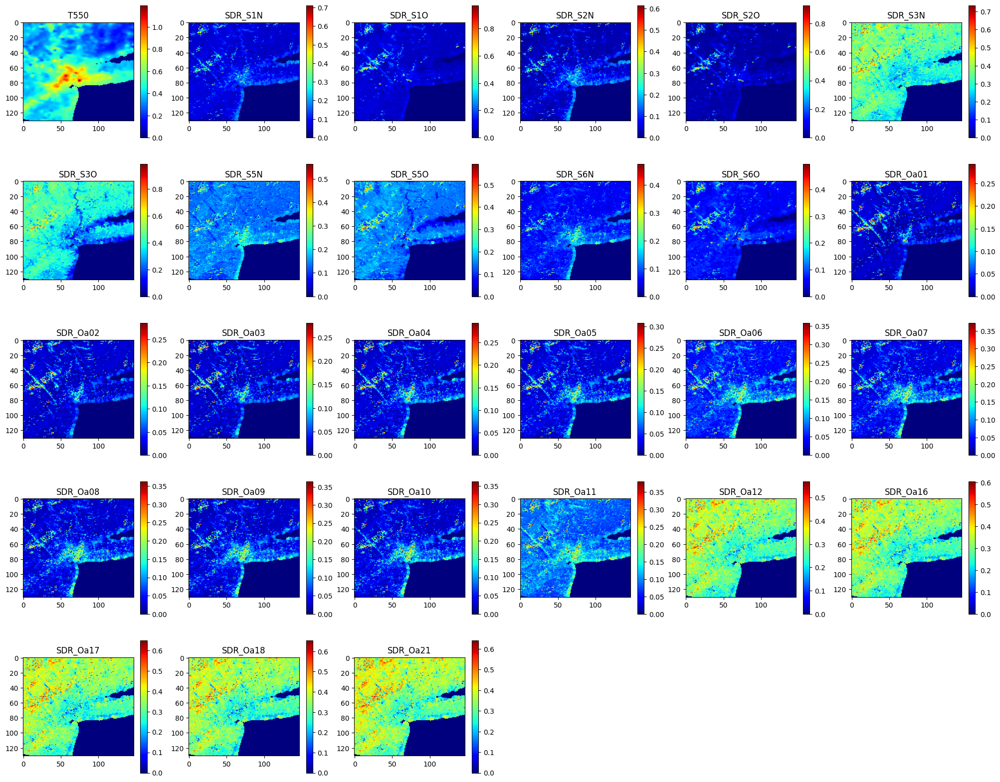

In [54]:
# Mean data s3 water
plt.figure(figsize=(25, 20))
s3_sr_mean = np.ma.mean(s3_sr_stack, 0)
for x in range(len(s3_sr_band_names)):
    data = s3_sr_mean[x]
    data = fillnodata(
        data,
        mask=~data.mask * 1,
        max_search_distance=3,
        smoothing_iterations=1,
    )
    s3_sr_mean[x] = data
    plt.subplot(5, 6, x + 1)
    plt.imshow(data, cmap="jet")
    plt.colorbar()
    plt.title(f"{s3_sr_band_names[x]}")
plt.show()

In [55]:
# Save with rasterio
# Save sentinel-3 sr
s3_sr_output = np.nan_to_num(s3_sr_mean, nan=-9999)
with rio.open(
    "s3_sr.tif",
    "w",
    "COG",
    width=s3_sr_output.shape[2],
    height=s3_sr_output.shape[1],
    count=s3_sr_output.shape[0],
    transform=transform_extent_100,
    crs="EPSG:4326",
    dtype="float32",
    resample=Resampling.bilinear,
    nodata=-9999,
) as output:
    output.write(s3_sr_output)
    output.descriptions = tuple(s3_sr_band_names)


In [44]:
# Search for GOES data
goes_col = client.search(
    collections=["goes-cmi"],
    bbox=bounds,
    datetime=sample_temporal,
).item_collection()

if len(goes_col) > 0:
    print(f"Found {len(goes_col)} GOES scenes")
else:
    print("No GOES data available")

Found 456 GOES scenes


In [47]:
# Convert sample_temporal to more specific timeframe
from datetime import datetime, timedelta

# Parse the date
sample_date = datetime.strptime(sample_temporal, "%Y-%m-%d")
# Create time window (±1 hour from noon local time)
start_time = sample_date.replace(hour=11, minute=0)
end_time = sample_date.replace(hour=13, minute=0)
time_window = f"{start_time.strftime('%Y-%m-%dT%H:%M:%S')}/{end_time.strftime('%Y-%m-%dT%H:%M:%S')}"

# Search for GOES data with specific time window
goes_col = client.search(
    collections=["goes-cmi"],
    bbox=bounds,
    datetime=time_window,
).item_collection()

if len(goes_col) > 0:
    print(f"Found {len(goes_col)} GOES scenes between {start_time} and {end_time}")
    
    # Process GOES data
    goes_bands = ["CMI_C07", "CMI_C11", "CMI_C13", "CMI_C15"]  # Relevant bands for LST/temperature
    goes_stacks = []
    
    for item in goes_col:
        print(f"Processing {item.id}")
        images = []
        
        for band in goes_bands:
            if band in item.assets:
                print(f"Processing band {band}")
                with rio.open(item.assets[band].href) as source:
                    bounds_crs = tuple(extent.to_crs(source.crs).total_bounds)
                    window = windows.from_bounds(*bounds_crs, transform=source.transform)
                    transform_window = windows.transform(window, source.transform)
                    image = source.read(
                        1,
                        boundless=True,
                        window=window,
                        fill_value=source.nodata,
                    )
                    image, new_transform = reproject(
                        image,
                        np.empty(shape_100, dtype=np.float32),
                        src_transform=transform_window,
                        src_crs=source.crs,
                        src_nodata=source.nodata,
                        dst_transform=transform_extent_100,
                        dst_crs="EPSG:4326",
                        dst_nodata=-9999,
                        resampling=Resampling.bilinear,
                    )
                    
                    # Mask invalid values
                    image = np.ma.array(image, mask=(image == source.nodata))
                    images.append(image)
        
        if images:
            goes_stack = np.ma.stack(images)
            goes_stacks.append(goes_stack)
    
    if goes_stacks:
        # Calculate median of all timestamps
        goes_median = np.ma.median(np.ma.stack(goes_stacks), 0)
        
        # Fill nodata values
        for i in range(len(goes_bands)):
            goes_median[i] = fillnodata(
                goes_median[i],
                mask=~goes_median[i].mask * 1,
                max_search_distance=3,
                smoothing_iterations=1,
            )
        
        # Save GOES data
        goes_output = np.nan_to_num(goes_median, nan=-9999)
        with rio.open(
            "goes_data.tif",
            "w",
            "COG",
            count=goes_output.shape[0],
            height=goes_output.shape[1],
            width=goes_output.shape[2],
            compress="zstd",
            resampling="bilinear",
            dtype="float32",
            nodata=-9999,
            crs="EPSG:4326",
            transform=transform_extent_100,
        ) as output:
            output.write(goes_output)
            output.descriptions = tuple(goes_bands)
            print("Successfully saved GOES data to goes_data.tif")
            
        # Plot the results
        plt.figure(figsize=(15, 5))
        for i, band in enumerate(goes_bands):
            plt.subplot(1, 4, i+1)
            plt.imshow(goes_median[i], cmap='jet')
            plt.colorbar()
            plt.title(band)
        plt.tight_layout()
        plt.show()
        
else:
    print("No GOES data available for the specified time window")

Found 60 GOES scenes between 2021-07-24 11:00:00 and 2021-07-24 13:00:00
Processing OR_ABI-L2-C-M6_G16_s20212051256190
Processing OR_ABI-L2-C-M6_G16_s20212051251190
Processing OR_ABI-L2-F-M6_G16_s20212051250224
Processing OR_ABI-L2-C-M6_G16_s20212051246190
Processing OR_ABI-L2-C-M6_G16_s20212051241190
Processing OR_ABI-L2-F-M6_G16_s20212051240224
Processing OR_ABI-L2-C-M6_G16_s20212051236190
Processing OR_ABI-L2-C-M6_G16_s20212051231190
Processing OR_ABI-L2-F-M6_G16_s20212051230224
Processing OR_ABI-L2-C-M6_G16_s20212051226190
Processing OR_ABI-L2-M1-M6_G16_s20212051222268
Processing OR_ABI-L2-M1-M6_G16_s20212051221268
Processing OR_ABI-L2-C-M6_G16_s20212051221190
Processing OR_ABI-L2-M1-M6_G16_s20212051220297
Processing OR_ABI-L2-F-M6_G16_s20212051220224
Processing OR_ABI-L2-M1-M6_G16_s20212051219268
Processing OR_ABI-L2-M1-M6_G16_s20212051218268
Processing OR_ABI-L2-M1-M6_G16_s20212051217268
Processing OR_ABI-L2-M1-M6_G16_s20212051216268
Processing OR_ABI-L2-C-M6_G16_s20212051216190


Optimal Shapes 100 meter: (131, 147)
Found 60 GOES scenes between 2021-07-24 11:00:00 and 2021-07-24 13:00:00
Processing scene 1/10: OR_ABI-L2-C-M6_G16_s20212051256190
Processing band C07_2km... Done
Processing band C11_2km... Done
Processing band C13_2km... Done
Processing band C15_2km... Done
Successfully processed all bands for scene 1
Processing scene 2/10: OR_ABI-L2-C-M6_G16_s20212051251190
Processing band C07_2km... Done
Processing band C11_2km... Done
Processing band C13_2km... Done
Processing band C15_2km... Done
Successfully processed all bands for scene 2
Processing scene 3/10: OR_ABI-L2-F-M6_G16_s20212051250224
Processing band C07_2km... Done
Processing band C11_2km... Done
Processing band C13_2km... Done
Processing band C15_2km... Done
Successfully processed all bands for scene 3
Processing scene 4/10: OR_ABI-L2-C-M6_G16_s20212051246190
Processing band C07_2km... Done
Processing band C11_2km... Done
Processing band C13_2km... Done
Processing band C15_2km... Done
Successfull

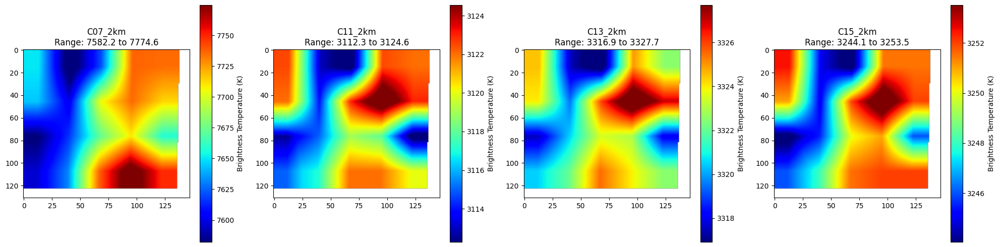

In [52]:
# First, define the shape_100 variable
width_100 = int(abs(bounds[0] - bounds[2]) * 111_000 / 100)
height_100 = int(abs(bounds[1] - bounds[3]) * 111_000 / 100)
shape_100 = (height_100, width_100)
transform_extent_100 = transform.from_bounds(*bounds, height=height_100, width=width_100)
print(f"Optimal Shapes 100 meter: {shape_100}")

# Then process GOES data
goes_bands = ["C07_2km", "C11_2km", "C13_2km", "C15_2km"]

goes_col = client.search(
    collections=["goes-cmi"],
    bbox=bounds,
    datetime=time_window,
).item_collection()

if len(goes_col) > 0:
    print(f"Found {len(goes_col)} GOES scenes between {start_time} and {end_time}")
    
    goes_stacks = []
    
    # Limit to first 10 scenes for testing
    for item_idx, item in enumerate(goes_col[:10]):  # Only process first 10 scenes
        print(f"Processing scene {item_idx + 1}/10: {item.id}")
        images = []
        
        for band in goes_bands:
            if band in item.assets:
                print(f"Processing band {band}", end="... ")
                try:
                    with rio.open(item.assets[band].href) as source:
                        bounds_crs = tuple(extent.to_crs(source.crs).total_bounds)
                        window = windows.from_bounds(*bounds_crs, transform=source.transform)
                        transform_window = windows.transform(window, source.transform)
                        image = source.read(
                            1,
                            boundless=True,
                            window=window,
                            fill_value=source.nodata,
                        )
                        image, new_transform = reproject(
                            image,
                            np.empty(shape_100, dtype=np.float32),
                            src_transform=transform_window,
                            src_crs=source.crs,
                            src_nodata=source.nodata,
                            dst_transform=transform_extent_100,
                            dst_crs="EPSG:4326",
                            dst_nodata=-9999,
                            resampling=Resampling.bilinear,
                        )
                        
                        # Mask invalid values
                        image = np.ma.array(image, mask=(image == source.nodata))
                        images.append(image)
                        print("Done")
                except Exception as e:
                    print(f"Error: {str(e)}")
                    continue
        
        if len(images) == len(goes_bands):
            print(f"Successfully processed all bands for scene {item_idx + 1}")
            goes_stack = np.ma.stack(images)
            goes_stacks.append(goes_stack)
        else:
            print(f"Skipping scene {item_idx + 1} - not all bands were processed")
    
    
if goes_stacks:
    print(f"\nProcessing {len(goes_stacks)} valid GOES scenes")
    goes_median = np.ma.median(np.ma.stack(goes_stacks), 0)
    
    # Fill nodata values
    for i in range(len(goes_bands)):
        goes_median[i] = fillnodata(
            goes_median[i],
            mask=~goes_median[i].mask * 1,
            max_search_distance=3,
            smoothing_iterations=1,
        )
    
    # Save GOES data
    goes_output = np.nan_to_num(goes_median, nan=-9999)
    try:
        with rio.open(
            "goes_data.tif",
            "w",
            "COG",
            count=goes_output.shape[0],
            height=goes_output.shape[1],
            width=goes_output.shape[2],
            compress="zstd",
            resampling="bilinear",
            dtype="float32",
            nodata=-9999,
            crs="EPSG:4326",
            transform=transform_extent_100,
        ) as output:
            output.write(goes_output)
            output.descriptions = tuple(goes_bands)
        print("\nSuccessfully saved GOES data to goes_data.tif")
        
        # Plot dengan handling nodata yang lebih baik
        plt.figure(figsize=(20, 5))
        for i, band in enumerate(goes_bands):
            plt.subplot(1, 4, i+1)
            
            # Buat masked array untuk menghilangkan nodata
            data = np.ma.masked_where(goes_output[i] <= -9990, goes_output[i])
            
            # Print statistik data (tanpa nodata)
            valid_data = data.compressed()  # hanya data valid
            print(f"\nBand {band} statistics (valid data only):")
            print(f"Min: {np.min(valid_data):.2f}")
            print(f"Max: {np.max(valid_data):.2f}")
            print(f"Mean: {np.mean(valid_data):.2f}")
            print(f"Std: {np.std(valid_data):.2f}")
            
            # Normalisasi data untuk visualisasi
            vmin = np.percentile(valid_data, 2)  # 2nd percentile
            vmax = np.percentile(valid_data, 98)  # 98th percentile
            
            # Plot dengan colormap yang sesuai
            im = plt.imshow(data, cmap='jet', vmin=vmin, vmax=vmax)
            plt.colorbar(im, label='Brightness Temperature (K)')
            plt.title(f"{band}\nRange: {vmin:.1f} to {vmax:.1f}")
            
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"\nError saving GOES data: {str(e)}")
else:
    print("\nNo valid GOES stacks were created")